<a href="https://colab.research.google.com/github/saswatt23/mental-fitness-tracker/blob/main/mental_fitness_trackeer.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# importing libraries

In [ ]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import os
# from google.colab import drive
# drive.mount('/content/drive')

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import warnings
warnings.filterwarnings('ignore')

# reading data

In [ ]:
df1 = pd.read_csv('mental-and-substance-use-as-share-of-disease.csv')
df2 =pd.read_csv('prevalence-by-mental-and-substance-use-disorder.csv')

In [ ]:
df1.head()

,Entity,Code,Year,DALYs (Disability-Adjusted Life Years) - Mental disorders - Sex: Both - Age: All Ages (Percent)
0,Afghanistan,AFG,1990,1.696670
1,Afghanistan,AFG,1991,1.734281
2,Afghanistan,AFG,1992,1.791189
3,Afghanistan,AFG,1993,1.776779
4,Afghanistan,AFG,1994,1.712986


In [ ]:
df2.head()

,Entity,Code,Year,Prevalence - Schizophrenia - Sex: Both - Age: Age-standardized (Percent),Prevalence - Bipolar disorder - Sex: Both - Age: Age-standardized (Percent),Prevalence - Eating disorders - Sex: Both - Age: Age-standardized (Percent),Prevalence - Anxiety disorders - Sex: Both - Age: Age-standardized (Percent),Prevalence - Drug use disorders - Sex: Both - Age: Age-standardized (Percent),Prevalence - Depressive disorders - Sex: Both - Age: Age-standardized (Percent),Prevalence - Alcohol use disorders - Sex: Both - Age: Age-standardized (Percent)
0,Afghanistan,AFG,1990,0.228979,0.721207,0.131001,4.835127,0.454202,5.125291,0.444036
1,Afghanistan,AFG,1991,0.228120,0.719952,0.126395,4.821765,0.447112,5.116306,0.444250
2,Afghanistan,AFG,1992,0.227328,0.718418,0.121832,4.801434,0.441190,5.106558,0.445501
3,Afghanistan,AFG,1993,0.226468,0.717452,0.117942,4.789363,0.435581,5.100328,0.445958
4,Afghanistan,AFG,1994,0.225567,0.717012,0.114547,4.784923,0.431822,5.099424,0.445779


### merging two datasets

In [ ]:
data = pd.merge(df1, df2)
data.head()

,Entity,Code,Year,DALYs (Disability-Adjusted Life Years) - Mental disorders - Sex: Both - Age: All Ages (Percent),Prevalence - Schizophrenia - Sex: Both - Age: Age-standardized (Percent),Prevalence - Bipolar disorder - Sex: Both - Age: Age-standardized (Percent),Prevalence - Eating disorders - Sex: Both - Age: Age-standardized (Percent),Prevalence - Anxiety disorders - Sex: Both - Age: Age-standardized (Percent),Prevalence - Drug use disorders - Sex: Both - Age: Age-standardized (Percent),Prevalence - Depressive disorders - Sex: Both - Age: Age-standardized (Percent),Prevalence - Alcohol use disorders - Sex: Both - Age: Age-standardized (Percent)
0,Afghanistan,AFG,1990,1.696670,0.228979,0.721207,0.131001,4.835127,0.454202,5.125291,0.444036
1,Afghanistan,AFG,1991,1.734281,0.228120,0.719952,0.126395,4.821765,0.447112,5.116306,0.444250
2,Afghanistan,AFG,1992,1.791189,0.227328,0.718418,0.121832,4.801434,0.441190,5.106558,0.445501
3,Afghanistan,AFG,1993,1.776779,0.226468,0.717452,0.117942,4.789363,0.435581,5.100328,0.445958
4,Afghanistan,AFG,1994,1.712986,0.225567,0.717012,0.114547,4.784923,0.431822,5.099424,0.445779


# data cleaning

In [ ]:
data.isnull().sum()

Entity                                                                                               0
Code                                                                                               690
Year                                                                                                 0
DALYs (Disability-Adjusted Life Years) - Mental disorders - Sex: Both - Age: All Ages (Percent)      0
Prevalence - Schizophrenia - Sex: Both - Age: Age-standardized (Percent)                             0
Prevalence - Bipolar disorder - Sex: Both - Age: Age-standardized (Percent)                          0
Prevalence - Eating disorders - Sex: Both - Age: Age-standardized (Percent)                          0
Prevalence - Anxiety disorders - Sex: Both - Age: Age-standardized (Percent)                         0
Prevalence - Drug use disorders - Sex: Both - Age: Age-standardized (Percent)                        0
Prevalence - Depressive disorders - Sex: Both - Age: Age-standardized (Pe

In [ ]:
data.drop('Code',axis=1,inplace=True)


In [ ]:
data.head()

,Entity,Year,DALYs (Disability-Adjusted Life Years) - Mental disorders - Sex: Both - Age: All Ages (Percent),Prevalence - Schizophrenia - Sex: Both - Age: Age-standardized (Percent),Prevalence - Bipolar disorder - Sex: Both - Age: Age-standardized (Percent),Prevalence - Eating disorders - Sex: Both - Age: Age-standardized (Percent),Prevalence - Anxiety disorders - Sex: Both - Age: Age-standardized (Percent),Prevalence - Drug use disorders - Sex: Both - Age: Age-standardized (Percent),Prevalence - Depressive disorders - Sex: Both - Age: Age-standardized (Percent),Prevalence - Alcohol use disorders - Sex: Both - Age: Age-standardized (Percent)
0,Afghanistan,1990,1.696670,0.228979,0.721207,0.131001,4.835127,0.454202,5.125291,0.444036
1,Afghanistan,1991,1.734281,0.228120,0.719952,0.126395,4.821765,0.447112,5.116306,0.444250
2,Afghanistan,1992,1.791189,0.227328,0.718418,0.121832,4.801434,0.441190,5.106558,0.445501
3,Afghanistan,1993,1.776779,0.226468,0.717452,0.117942,4.789363,0.435581,5.100328,0.445958
4,Afghanistan,1994,1.712986,0.225567,0.717012,0.114547,4.784923,0.431822,5.099424,0.445779


In [ ]:
data.size,data.shape

(68400, (6840, 10))

In [ ]:
data.set_axis(['Country','Year','Schizophrenia', 'Bipolar_disorder', 'Eating_disorder','Anxiety','drug_usage','depression','alcohol','mental_fitness'], axis='columns')

,Country,Year,Schizophrenia,Bipolar_disorder,Eating_disorder,Anxiety,drug_usage,depression,alcohol,mental_fitness
0,Afghanistan,1990,1.696670,0.228979,0.721207,0.131001,4.835127,0.454202,5.125291,0.444036
1,Afghanistan,1991,1.734281,0.228120,0.719952,0.126395,4.821765,0.447112,5.116306,0.444250
2,Afghanistan,1992,1.791189,0.227328,0.718418,0.121832,4.801434,0.441190,5.106558,0.445501
3,Afghanistan,1993,1.776779,0.226468,0.717452,0.117942,4.789363,0.435581,5.100328,0.445958
4,Afghanistan,1994,1.712986,0.225567,0.717012,0.114547,4.784923,0.431822,5.099424,0.445779
...,...,...,...,...,...,...,...,...,...,...
6835,Zimbabwe,2015,2.193166,0.209359,0.560882,0.099610,3.315701,0.599604,3.548613,1.734969
6836,Zimbabwe,2016,2.279813,0.209979,0.561768,0.100821,3.324230,0.603658,3.557508,1.689281
6837,Zimbabwe,2017,2.364265,0.210631,0.562612,0.101671,3.330569,0.608096,3.564138,1.651805
6838,Zimbabwe,2018,2.472949,0.211237,0.563283,0.102398,3.317500,0.609065,3.563141,1.686711


In [ ]:
data.head()

,Entity,Year,DALYs (Disability-Adjusted Life Years) - Mental disorders - Sex: Both - Age: All Ages (Percent),Prevalence - Schizophrenia - Sex: Both - Age: Age-standardized (Percent),Prevalence - Bipolar disorder - Sex: Both - Age: Age-standardized (Percent),Prevalence - Eating disorders - Sex: Both - Age: Age-standardized (Percent),Prevalence - Anxiety disorders - Sex: Both - Age: Age-standardized (Percent),Prevalence - Drug use disorders - Sex: Both - Age: Age-standardized (Percent),Prevalence - Depressive disorders - Sex: Both - Age: Age-standardized (Percent),Prevalence - Alcohol use disorders - Sex: Both - Age: Age-standardized (Percent)
0,Afghanistan,1990,1.696670,0.228979,0.721207,0.131001,4.835127,0.454202,5.125291,0.444036
1,Afghanistan,1991,1.734281,0.228120,0.719952,0.126395,4.821765,0.447112,5.116306,0.444250
2,Afghanistan,1992,1.791189,0.227328,0.718418,0.121832,4.801434,0.441190,5.106558,0.445501
3,Afghanistan,1993,1.776779,0.226468,0.717452,0.117942,4.789363,0.435581,5.100328,0.445958
4,Afghanistan,1994,1.712986,0.225567,0.717012,0.114547,4.784923,0.431822,5.099424,0.445779


In [ ]:
data["Entity"] = data["Entity"].astype("object")

# explaratory data analysis(EDA)

In [ ]:
# plt.figure(figsize=(12,6))
# sns.heatmap(data.corr(),annot=True,cmap='Greens')
# plt.plot()

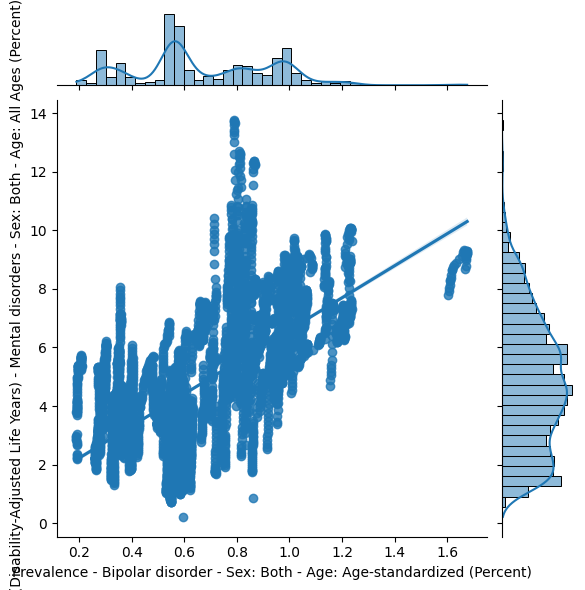

In [ ]:
sns.jointplot(data=data,x='Prevalence - Bipolar disorder - Sex: Both - Age: Age-standardized (Percent)',y='DALYs (Disability-Adjusted Life Years) - Mental disorders - Sex: Both - Age: All Ages (Percent)',kind='reg')
plt.show()

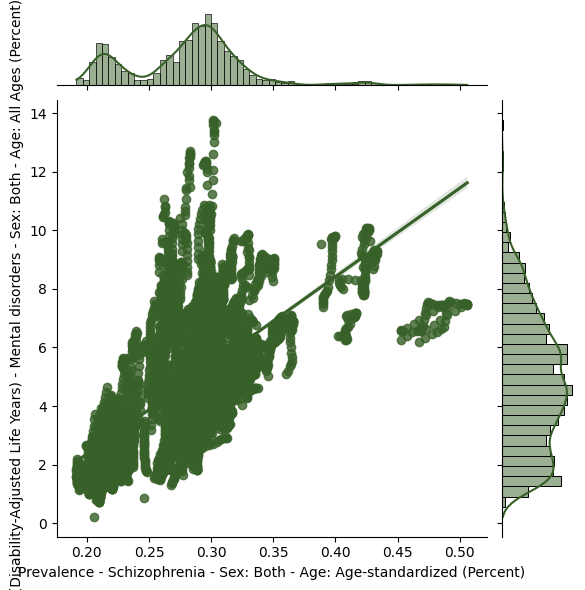

In [ ]:
sns.jointplot(x='Prevalence - Schizophrenia - Sex: Both - Age: Age-standardized (Percent)',y='DALYs (Disability-Adjusted Life Years) - Mental disorders - Sex: Both - Age: All Ages (Percent)',data=data,kind='reg',color=(0.22,0.38,0.16))
plt.show()

In [ ]:
sns.pairplot(data,corner=True, height=20)
plt.show()

In [ ]:
mean = data['DALYs (Disability-Adjusted Life Years) - Mental disorders - Sex: Both - Age: All Ages (Percent)'].mean()
mean

4.8180618117506135

In [ ]:
fig = px.pie(data, values='DALYs (Disability-Adjusted Life Years) - Mental disorders - Sex: Both - Age: All Ages (Percent)', names='Year')
fig.show()

# year wise variation in mental fitness in different countries

In [ ]:
fig = px.line(data, x="Year", y="DALYs (Disability-Adjusted Life Years) - Mental disorders - Sex: Both - Age: All Ages (Percent)", color='Country',markers=True,color_discrete_sequence=['rgb(1.00,1.00,0.10)','rgb(0.00,0.53,0.80)'],template='plotly', height=1000)
fig.show()

In [ ]:
df = data.copy()

In [ ]:
df.head()

,Entity,Year,DALYs (Disability-Adjusted Life Years) - Mental disorders - Sex: Both - Age: All Ages (Percent),Prevalence - Schizophrenia - Sex: Both - Age: Age-standardized (Percent),Prevalence - Bipolar disorder - Sex: Both - Age: Age-standardized (Percent),Prevalence - Eating disorders - Sex: Both - Age: Age-standardized (Percent),Prevalence - Anxiety disorders - Sex: Both - Age: Age-standardized (Percent),Prevalence - Drug use disorders - Sex: Both - Age: Age-standardized (Percent),Prevalence - Depressive disorders - Sex: Both - Age: Age-standardized (Percent),Prevalence - Alcohol use disorders - Sex: Both - Age: Age-standardized (Percent)
0,Afghanistan,1990,1.696670,0.228979,0.721207,0.131001,4.835127,0.454202,5.125291,0.444036
1,Afghanistan,1991,1.734281,0.228120,0.719952,0.126395,4.821765,0.447112,5.116306,0.444250
2,Afghanistan,1992,1.791189,0.227328,0.718418,0.121832,4.801434,0.441190,5.106558,0.445501
3,Afghanistan,1993,1.776779,0.226468,0.717452,0.117942,4.789363,0.435581,5.100328,0.445958
4,Afghanistan,1994,1.712986,0.225567,0.717012,0.114547,4.784923,0.431822,5.099424,0.445779


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6840 entries, 0 to 6839
Data columns (total 10 columns):
 #   Column                                                                                           Non-Null Count  Dtype  
---  ------                                                                                           --------------  -----  
 0   Entity                                                                                           6840 non-null   object 
 1   Year                                                                                             6840 non-null   int64  
 2   DALYs (Disability-Adjusted Life Years) - Mental disorders - Sex: Both - Age: All Ages (Percent)  6840 non-null   float64
 3   Prevalence - Schizophrenia - Sex: Both - Age: Age-standardized (Percent)                         6840 non-null   float64
 4   Prevalence - Bipolar disorder - Sex: Both - Age: Age-standardized (Percent)                      6840 non-null   float64
 5   Preval

In [ ]:
from sklearn.preprocessing import LabelEncoder
l=LabelEncoder()
for i in df.columns:
    if df[i].dtype == 'object':
        df[i]=l.fit_transform(df[i])

In [ ]:
X = df.drop('DALYs (Disability-Adjusted Life Years) - Mental disorders - Sex: Both - Age: All Ages (Percent)',axis=1)
y = df['DALYs (Disability-Adjusted Life Years) - Mental disorders - Sex: Both - Age: All Ages (Percent)']

from sklearn.model_selection import train_test_split
xtrain, xtest, ytrain, ytest = train_test_split(X, y, test_size=0.2, random_state=2)

In [ ]:
# X = df.drop('mental_fitness',axis=1)
# y = df['mental_fitness']

# from sklearn.model_selection import train_test_split
# xtrain, xtest, ytrain, ytest = train_test_split(X, y, test_size=0.2, random_state=2)

# applying classification algorithm

# linear regression

In [ ]:
# from sklearn.linear_model import LinearRegression
# from sklearn.metrics import mean_squared_error, r2_score
# lr = LinearRegression()
# lr.fit(xtrain,ytrain)

# # model evaluation for training set
# ytrain_pred = lr.predict(xtrain)
# mse = mean_squared_error(ytrain, ytrain_pred)
# rmse = (np.sqrt(mean_squared_error(ytrain, ytrain_pred)))
# r2 = r2_score(ytrain, ytrain_pred)

# print("The model performance for training set")
# print("--------------------------------------")
# print('MSE is {}'.format(mse))
# print('RMSE is {}'.format(rmse))
# print('R2 score is {}'.format(r2))
# print("\n")

# # model evaluation for testing set
# ytest_pred = lr.predict(xtest)
# mse = mean_squared_error(ytest, ytest_pred)
# rmse = (np.sqrt(mean_squared_error(ytest, ytest_pred)))
# r2 = r2_score(ytest, ytest_pred)

# print("The model performance for testing set")
# print("--------------------------------------")
# print('MSE is {}'.format(mse))
# print('RMSE is {}'.format(rmse))
# print('R2 score is {}'.format(r2))

# random forest regression

In [ ]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score
rf = RandomForestRegressor()
rf.fit(xtrain, ytrain)

# model evaluation for training set
ytrain_pred = rf.predict(xtrain)
mse = mean_squared_error(ytrain, ytrain_pred)
rmse = (np.sqrt(mean_squared_error(ytrain, ytrain_pred)))
r2 = r2_score(ytrain, ytrain_pred)

print("The model performance for training set")
print("--------------------------------------")
print('MSE is {}'.format(mse))
print('RMSE is {}'.format(rmse))
print('R2 score is {}'.format(r2))
print("\n")

# model evaluation for testing set
ytest_pred = rf.predict(xtest)
mse = mean_squared_error(ytest, ytest_pred)
rmse = (np.sqrt(mean_squared_error(ytest, ytest_pred)))
r2 = r2_score(ytest, ytest_pred)

print("The model performance for testing set")
print("--------------------------------------")
print('MSE is {}'.format(mse))
print('RMSE is {}'.format(rmse))
print('R2 score is {}'.format(r2))

The model performance for training set
--------------------------------------
MSE is 0.004981951220258732
RMSE is 0.07058293859183487
R2 score is 0.9990728446061997


The model performance for testing set
--------------------------------------
MSE is 0.029265736335255418
RMSE is 0.1710723131756142
R2 score is 0.9939161887620473


# decission tree regression

In [ ]:
from sklearn.tree import DecisionTreeRegressor
dtr=DecisionTreeRegressor(random_state=0)
dtr.fit(xtrain,ytrain)

#predicting the value

ytest_pred=dtr.predict(xtest)

#evaluating the model

from sklearn.metrics import r2_score,mean_squared_error
print("Results for Decision Tree Regression:\n1)Mean Square Error={}\n2)R-Square Score={}".format(mean_squared_error(ytest,ytest_pred),r2_score(ytest,ytest_pred)))

Results for Decision Tree Regression:
1)Mean Square Error=0.07894911599154122
2)R-Square Score=0.9835879229692521


# svm regression

In [ ]:
from sklearn.svm import SVR
svr=SVR()
svr.fit(xtrain,ytrain)

#predicting the value

ytest_pred=svr.predict(xtest)

#evaluating the model

from sklearn.metrics import r2_score,mean_squared_error
print("Results for SVM Regression:\n1)Mean Square Error={}\n2)R-Square Score={}".format(mean_squared_error(ytest,ytest_pred),r2_score(ytest,ytest_pred)))




Results for SVM Regression:
1)Mean Square Error=4.7911713917240055
2)R-Square Score=0.0040031105995593785


# conclusion

Random Forest Regression works well on both train and test sets with r2 score of 0.99.
 As well as Decision Tree Regression also works well on both train and test set with r2 score of 0.98.

In [ ]:
np.random.seed(range(0,100))
print("OUTPUT WINDOW\n\n")
country=l.fit_transform([input('Enter Your country Name:')])
year=int(input("Enter the Year:"))
schi=(float(input("Enter your Schizophrenia rate in % (if not enter 0):")))*100
bipo_dis=(float(input("Enter your Bipolar disorder rate in % (if not enter 0):")))*100
eat_dis=(float(input("Enter your Eating disorder rate in % (if not enter 0):")))*100
anx=(float(input("Enter your Anxiety rate in % (if not enter 0):")))*100
drug_use=(float(input("Enter your Drug Usage rate in per year % (if not enter 0):")))*100
depr=(float(input("Enter your Depression rate in % (if not enter 0):")))*100
alch=(float(input("Enter your Alcohol Consuming rate per year in % (if not enter 0):")))*100

prediction=rf.predict([[country,year,schi,bipo_dis,eat_dis,anx,drug_use,depr,alch]])
print("\n\nYour Mental Fitness is {}%".format(prediction))
print("\n\nEND")

OUTPUT WINDOW


Enter Your country Name:INDIA
Enter the Year:0
Enter your Schizophrenia rate in % (if not enter 0):0
Enter your Bipolar disorder rate in % (if not enter 0):0
Enter your Eating disorder rate in % (if not enter 0):0
Enter your Anxiety rate in % (if not enter 0):0
Enter your Drug Usage rate in per year % (if not enter 0):0
Enter your Depression rate in % (if not enter 0):0
Enter your Alcohol Consuming rate per year in % (if not enter 0):0


Your Mental Fitness is [0.86013825]%


END
